## Crash Reporting - Drivers Dataset Exploratory Data Analysis

This dataset provides information on motor vehicle operators (drivers) involved in traffic collisions occurring on county and local roadways. The dataset reports details of all traffic collisions occurring on county and local roadways within Montgomery County, as collected via the Automated Crash Reporting System (ACRS) of the Maryland State Police, and reported by the Montgomery County Police, Gaithersburg Police, Rockville Police, or the Maryland-National Capital Park Police. This dataset shows each collision data recorded and the drivers involved.

Please note that these collision reports are based on preliminary information supplied to the Police Department by the reporting parties. Therefore, the collision data available on this web page may reflect:


    -Information not yet verified by further investigation
    -Information that may include verified and unverified collision data -Preliminary collision classifications may be changed at a later date based upon further investigation
    -Information may include mechanical or human error

This dataset can be joined with the other 2 Crash Reporting datasets (see URLs below) by the State Report Number. * Crash Reporting - Incidents Data at https://data.montgomerycountymd.gov/Public-Safety/Crash-Reporting-Incidents-Data/bhju-22kf * Crash Reporting - Non-Motorists Data at https://data.montgomerycountymd.gov/Public-Safety/Crash-Reporting-Non-Motorists-Data/n7fk-dce5

Update Frequency : Weekly

In [ ]:
!pip install keplergl

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.7/9.7 MB 19.9 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
  Created wheel for keplergl: filename=keplergl-0.3.2-py2.py3-none-any.whl size=17922315 sha256=e5fa0de2ff2986084009d5a7369d0b329e0d8c3684dff8b37096eee74280dc3c
  Stored in directory: /root/.cache/pip/wheels/e5/e9/db/b8b8f2fcb5cb1cd7268d88959fce267bc00697cb8f50dcd0d9
Successfully built keplergl


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import SelectFromModel
from sklearn.metrics import accuracy_score
from imblearn.over_sampling import RandomOverSampler
from xgboost import XGBClassifier
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import CategoricalNB
%matplotlib inline

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
df=pd.read_csv('/content/drive/MyDrive/Data/Crash_Reporting_-_Drivers_Data.csv')
df.head()

<ipython-input-4-2a7b6277ee22>:1: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  df=pd.read_csv('/content/drive/MyDrive/Data/ML_Assignment4/Crash_Reporting_-_Drivers_Data.csv')


,Report Number,Local Case Number,Agency Name,ACRS Report Type,Crash Date/Time,Route Type,Road Name,Cross-Street Type,Cross-Street Name,Off-Road Description,...,Speed Limit,Driverless Vehicle,Parked Vehicle,Vehicle Year,Vehicle Make,Vehicle Model,Equipment Problems,Latitude,Longitude,Location
0,MCP3040003N,190026050,Montgomery County Police,Property Damage Crash,05/31/2019 03:00:00 PM,NaN,NaN,NaN,NaN,PARKING LOT OF 3215 SPARTAN RD,...,15,No,No,2004,HONDA,TK,UNKNOWN,39.150044,-77.063089,"(39.15004368, -77.06308884)"
1,EJ78850038,230034791,Gaithersburg Police Depar,Property Damage Crash,07/21/2023 05:59:00 PM,Maryland (State),FREDERICK RD,Unknown,WATKINS MILL RD,NaN,...,40,No,No,2011,GMC,TK,NO MISUSE,39.159264,-77.219025,"(39.1592635, -77.21902483)"
2,MCP2009002G,230034583,Montgomery County Police,Property Damage Crash,07/20/2023 03:10:00 PM,Maryland (State),GEORGIA AVE,Maryland (State),NORBECK RD,NaN,...,35,No,No,2019,FORD,F150,NO MISUSE,39.109535,-77.075806,"(39.10953506, -77.07580619)"
3,MCP3201004C,230035036,Montgomery County Police,Property Damage Crash,07/23/2023 12:10:00 PM,County,CRYSTAL ROCK DR,County,WATERS LANDING DR,NaN,...,40,No,No,2016,KIA,SW,NO MISUSE,39.190149,-77.266766,"(39.19014917, -77.26676583)"
4,MCP23290028,230035152,Montgomery County Police,Property Damage Crash,07/24/2023 06:10:00 AM,County,MONTGOMERY VILLAGE AVE,County,CENTERWAY RD,NaN,...,35,No,No,2016,TOYT,TK,NO MISUSE,39.172558,-77.203745,"(39.17255801, -77.20374546)"


In [ ]:
df.columns

Index(['Report Number', 'Local Case Number', 'Agency Name', 'ACRS Report Type',
       'Crash Date/Time', 'Route Type', 'Road Name', 'Cross-Street Type',
       'Cross-Street Name', 'Off-Road Description', 'Municipality',
       'Related Non-Motorist', 'Collision Type', 'Weather',
       'Surface Condition', 'Light', 'Traffic Control',
       'Driver Substance Abuse', 'Non-Motorist Substance Abuse', 'Person ID',
       'Driver At Fault', 'Injury Severity', 'Circumstance',
       'Driver Distracted By', 'Drivers License State', 'Vehicle ID',
       'Vehicle Damage Extent', 'Vehicle First Impact Location',
       'Vehicle Second Impact Location', 'Vehicle Body Type',
       'Vehicle Movement', 'Vehicle Continuing Dir', 'Vehicle Going Dir',
       'Speed Limit', 'Driverless Vehicle', 'Parked Vehicle', 'Vehicle Year',
       'Vehicle Make', 'Vehicle Model', 'Equipment Problems', 'Latitude',
       'Longitude', 'Location'],
      dtype='object')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 172105 entries, 0 to 172104
Data columns (total 43 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   Report Number                   172105 non-null  object 
 1   Local Case Number               172105 non-null  object 
 2   Agency Name                     172105 non-null  object 
 3   ACRS Report Type                172105 non-null  object 
 4   Crash Date/Time                 172105 non-null  object 
 5   Route Type                      155132 non-null  object 
 6   Road Name                       156168 non-null  object 
 7   Cross-Street Type               155099 non-null  object 
 8   Cross-Street Name               156154 non-null  object 
 9   Off-Road Description            15935 non-null   object 
 10  Municipality                    19126 non-null   object 
 11  Related Non-Motorist            5463 non-null    object 
 12  Collision Type  

In [ ]:
df.shape

(172105, 43)

In [ ]:
df.describe()

,Speed Limit,Vehicle Year,Latitude,Longitude
count,172105.000000,172105.000000,172105.000000,172105.000000
mean,32.549752,1966.306946,39.083119,-77.112343
std,11.059987,340.615468,0.072032,0.098571
min,0.000000,0.000000,37.720000,-79.486000
25%,25.000000,2006.000000,39.024417,-77.189327
50%,35.000000,2011.000000,39.074933,-77.105412
75%,40.000000,2015.000000,39.139742,-77.039592
max,75.000000,9999.000000,39.990414,-75.527708


##Check for Missing Values:
    
      
      To identify missing values in all columns, you can use the .isnull() method followed by .sum() to count the missing values per column.

Imputation of Missing Data
Another common need in feature engineering is handling of missing data.

Example of random integers as array

In [ ]:
# Example
from numpy import nan
X = np.array([[ nan, 0,   3  ],
              [ 3,   7,   9  ],
              [ 3,   5,   2  ],
              [ 4,   nan, 6  ],
              [ 8,   8,   1  ]])
y = np.array([14, 16, -1,  8, -5])



When applying a typical machine learning model to such data, we will need to first replace such missing data with some appropriate fill value.
This is known as *imputation* of missing values, and strategies range from simple (e.g., replacing missing values with the mean of the column) to sophisticated (e.g., using matrix completion or a robust model to handle such data).

The sophisticated approaches tend to be very application-specific, and we won't dive into them here.
For a baseline imputation approach, using the mean, median, or most frequent value, Scikit-Learn provides the ``Imputer`` class:

In [ ]:
from sklearn.impute import SimpleImputer
imp = SimpleImputer(strategy='mean')
X2 = imp.fit_transform(X)
X2

array([[4.5, 0. , 3. ],
       [3. , 7. , 9. ],
       [3. , 5. , 2. ],
       [4. , 5. , 6. ],
       [8. , 8. , 1. ]])

In [ ]:
# Check for missing values in each column for Crash Dataset
missing_values = df.isnull().sum()
print(missing_values)

Report Number                          0
Local Case Number                      0
Agency Name                            0
ACRS Report Type                       0
Crash Date/Time                        0
Route Type                         16973
Road Name                          15937
Cross-Street Type                  17006
Cross-Street Name                  15951
Off-Road Description              156170
Municipality                      152979
Related Non-Motorist              166642
Collision Type                       585
Weather                            13354
Surface Condition                  20118
Light                               1445
Traffic Control                    25469
Driver Substance Abuse             31324
Non-Motorist Substance Abuse      167788
Person ID                              0
Driver At Fault                        0
Injury Severity                        0
Circumstance                      140746
Driver Distracted By                   0
Drivers License 

In the crash dataset the forward fill and backward fill is used to replace NaN values. Forward filling fills missing values with previous data while Backward filling fills missing values with next data point.

In [ ]:
df = df.fillna(method="ffill")
df = df.fillna(method="bfill")

In [ ]:
missing_values = df.isnull().sum()
print(missing_values)

Report Number                     0
Local Case Number                 0
Agency Name                       0
ACRS Report Type                  0
Crash Date/Time                   0
Route Type                        0
Road Name                         0
Cross-Street Type                 0
Cross-Street Name                 0
Off-Road Description              0
Municipality                      0
Related Non-Motorist              0
Collision Type                    0
Weather                           0
Surface Condition                 0
Light                             0
Traffic Control                   0
Driver Substance Abuse            0
Non-Motorist Substance Abuse      0
Person ID                         0
Driver At Fault                   0
Injury Severity                   0
Circumstance                      0
Driver Distracted By              0
Drivers License State             0
Vehicle ID                        0
Vehicle Damage Extent             0
Vehicle First Impact Locatio

##Validate Data Consistency:


    For validating data consistency, let’s focus on the ‘Driver At Fault’ column. Ensure that it only contains consistent values like ‘Yes’ or ‘No’.

In [ ]:
# Check unique values in 'Driver At Fault'
unique_values = df['Driver At Fault'].unique()
print(unique_values)



['Yes' 'No' 'Unknown']


In [ ]:
# Replace inconsistent values (if needed)
df['Driver At Fault'] = df['Driver At Fault'].replace({'Y': 'Yes', 'N': 'No'})

# Verify consistency after replacement
unique_values_after = df['Driver At Fault'].unique()
print(unique_values_after)

['Yes' 'No' 'Unknown']


Identify and Handle Duplicate Records:
    
    To identify duplicate records, use the .duplicated() method.To handle duplicates, you can drop them using .drop_duplicates().

In [ ]:
# Identify duplicate records
duplicates = df[df.duplicated()]
print(f"Number of duplicate records: {len(duplicates)}")

# Drop duplicates (if needed)
df_cleaned = df.drop_duplicates()

# Verify the cleaned DataFrame
print(f"Number of records after removing duplicates: {len(df_cleaned)}")

Number of duplicate records: 0
Number of records after removing duplicates: 172105


##Temporal Analysis:

In the context of accident data, temporal analysis would involve investigating how accident-related variables (such as accident frequency, severity, or contributing factors) vary over different time intervals.

    Extract date and time components from ‘Crash Date/Time’.
    Analyze trends over time (e.g., monthly accident frequency).



Extract Date and Time Components:
  
    Convert the ‘Crash Date/Time’ column to a Pandas datetime format.
    Extract relevant components such as year, month, day, and hour.

In [ ]:
# Convert 'Crash Date/Time' to datetime
df['Crash Date/Time'] = pd.to_datetime(df['Crash Date/Time'])

# Extract date components
df['Year'] = df['Crash Date/Time'].dt.year
df['Month'] = df['Crash Date/Time'].dt.month
df['Day'] = df['Crash Date/Time'].dt.day

# Extract time components
df['Hour'] = df['Crash Date/Time'].dt.hour

<ipython-input-17-1d8bdfd67ad8>:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Crash Date/Time'] = pd.to_datetime(df['Crash Date/Time'])


In [ ]:
df.columns

Index(['Report Number', 'Local Case Number', 'Agency Name', 'ACRS Report Type',
       'Crash Date/Time', 'Route Type', 'Road Name', 'Cross-Street Type',
       'Cross-Street Name', 'Off-Road Description', 'Municipality',
       'Related Non-Motorist', 'Collision Type', 'Weather',
       'Surface Condition', 'Light', 'Traffic Control',
       'Driver Substance Abuse', 'Non-Motorist Substance Abuse', 'Person ID',
       'Driver At Fault', 'Injury Severity', 'Circumstance',
       'Driver Distracted By', 'Drivers License State', 'Vehicle ID',
       'Vehicle Damage Extent', 'Vehicle First Impact Location',
       'Vehicle Second Impact Location', 'Vehicle Body Type',
       'Vehicle Movement', 'Vehicle Continuing Dir', 'Vehicle Going Dir',
       'Speed Limit', 'Driverless Vehicle', 'Parked Vehicle', 'Vehicle Year',
       'Vehicle Make', 'Vehicle Model', 'Equipment Problems', 'Latitude',
       'Longitude', 'Location', 'Year', 'Month', 'Day', 'Hour'],
      dtype='object')

Analyze Trends Over Time:
    
    Calculate monthly accident frequency and visualize it using a bar plot.

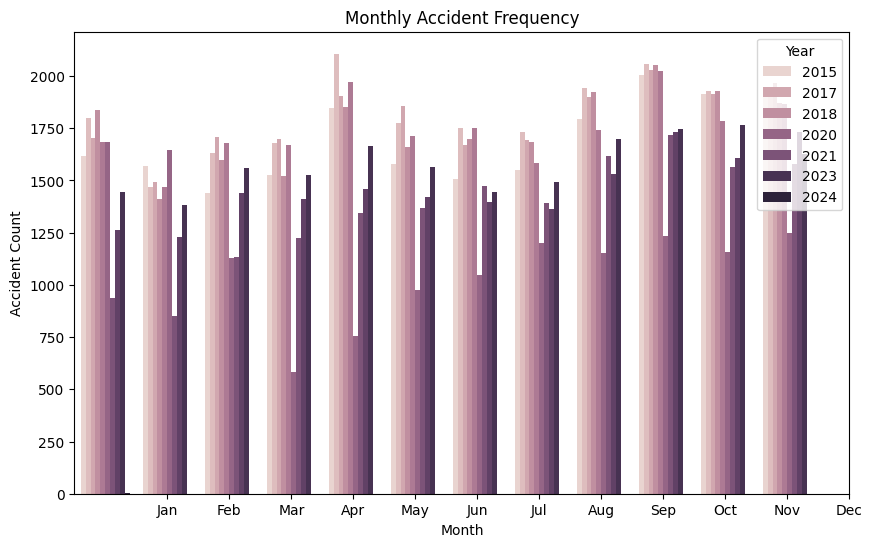

In [ ]:
# Group by month and count accidents
monthly_accidents = df.groupby(['Year', 'Month'])['Report Number'].count().reset_index()

# Plot monthly accident frequency
plt.figure(figsize=(10, 6))
sns.barplot(x='Month', y='Report Number', hue='Year', data=monthly_accidents)
plt.title('Monthly Accident Frequency')
plt.xlabel('Month')
plt.ylabel('Accident Count')
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
# I guess here range should be 12 as the graph doesn't seemed aligned.
plt.legend(title='Year')
plt.show()


##Geospatial Analysis:
    
    Plot accidents on a map using ‘Latitude’ and ‘Longitude’.
    Identify accident-prone areas or intersections.

In [ ]:
df_map = df[['Crash Date/Time', 'Collision Type','Injury Severity', 'Latitude','Longitude']]

In [ ]:
from google.colab import output
output.enable_custom_widget_manager()

In [ ]:
import keplergl
from keplergl import KeplerGl
map = KeplerGl(height=500)
map.add_data(df_map,"EDA")
map

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(data={'EDA': {'index': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,…

Support for third party widgets will remain active for the duration of the session. To disable support:

##Categorical Analysis:
    Explore columns like Severity, State, City, and Weather:
    Count unique values and visualize their distributions.
    Identify states or cities with the highest accident rates.
    Investigate how weather conditions impact accidents.

In [ ]:
df.columns

Index(['Report Number', 'Local Case Number', 'Agency Name', 'ACRS Report Type',
       'Crash Date/Time', 'Route Type', 'Road Name', 'Cross-Street Type',
       'Cross-Street Name', 'Off-Road Description', 'Municipality',
       'Related Non-Motorist', 'Collision Type', 'Weather',
       'Surface Condition', 'Light', 'Traffic Control',
       'Driver Substance Abuse', 'Non-Motorist Substance Abuse', 'Person ID',
       'Driver At Fault', 'Injury Severity', 'Circumstance',
       'Driver Distracted By', 'Drivers License State', 'Vehicle ID',
       'Vehicle Damage Extent', 'Vehicle First Impact Location',
       'Vehicle Second Impact Location', 'Vehicle Body Type',
       'Vehicle Movement', 'Vehicle Continuing Dir', 'Vehicle Going Dir',
       'Speed Limit', 'Driverless Vehicle', 'Parked Vehicle', 'Vehicle Year',
       'Vehicle Make', 'Vehicle Model', 'Equipment Problems', 'Latitude',
       'Longitude', 'Location', 'Year', 'Month', 'Day', 'Hour'],
      dtype='object')

<ipython-input-24-cd63669ffe4d>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=severity_counts.index, y=severity_counts.values, palette='viridis')


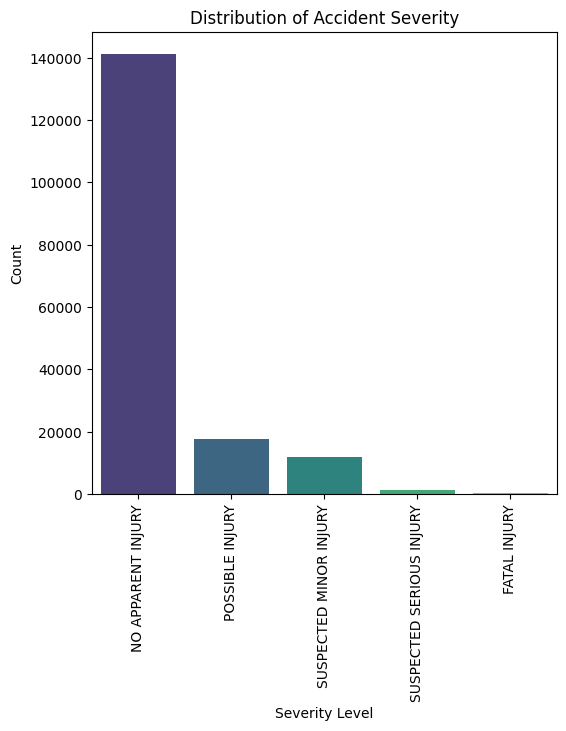

In [ ]:
# Count unique values in the 'Severity' column
severity_counts = df['Injury Severity'].value_counts()

# Visualize severity distribution
plt.figure(figsize=(6, 6))
sns.barplot(x=severity_counts.index, y=severity_counts.values, palette='viridis')
plt.title('Distribution of Accident Severity')
plt.xlabel('Severity Level')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()



In [ ]:
# Top Roads with the highest accident rates
top_roads = df['Road Name'].value_counts().nlargest(5)
print("Top 5 Road Names with the highest accident rates:")
print(top_roads)

Top 5 Road Names with the highest accident rates:
Road Name
GEORGIA AVE          11925
NEW HAMPSHIRE AVE     7507
FREDERICK RD          6388
ROCKVILLE PIKE        5314
CONNECTICUT AVE       4486
Name: count, dtype: int64


In [ ]:
# Investigate how weather conditions impact accidents
weather_counts = df['Weather'].value_counts()
print("\nWeather conditions and their accident counts:")
print(weather_counts)


Weather conditions and their accident counts:
Weather
CLEAR                       126622
RAINING                      22331
CLOUDY                       18746
SNOW                          1573
UNKNOWN                        751
FOGGY                          726
WINTRY MIX                     422
OTHER                          398
SLEET                          238
SEVERE WINDS                   162
BLOWING SNOW                   121
BLOWING SAND, SOIL, DIRT        15
Name: count, dtype: int64


##Feature Engineering

    Explore various feature engineering techniques for the provided columns.
    Feature engineering aims to create new features, transform existing ones, and select relevant attributes to improve the performance of machine learning models.

###Feature Scaling

          Normalize numeric features to a common scale.
          Example for scaling ‘Speed Limit’:

In [ ]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
df['Scaled_Speed_Limit'] = scaler.fit_transform(df[['Speed Limit']])

In [ ]:
df['Scaled_Speed_Limit']

0         0.200000
1         0.533333
2         0.466667
3         0.533333
4         0.466667
            ...   
172100    0.333333
172101    0.466667
172102    0.533333
172103    0.466667
172104    0.466667
Name: Scaled_Speed_Limit, Length: 172105, dtype: float64

###One-Hot Encoding

In [ ]:
df_encoded = pd.get_dummies(df, columns=['Weather', 'Surface Condition'])
df_encoded = df_encoded.head(1)
df_encoded.T

,0
Report Number,MCP3040003N
Local Case Number,190026050
Agency Name,Montgomery County Police
ACRS Report Type,Property Damage Crash
Crash Date/Time,2019-05-31 15:00:00
...,...
Surface Condition_SLUSH,False
Surface Condition_SNOW,False
Surface Condition_UNKNOWN,False
Surface Condition_WATER(STANDING/MOVING),False


###Bins

In [ ]:
hour_bins = [0, 6, 12, 18, 24]
hour_labels = ['Night', 'Morning', 'Afternoon', 'Evening']
df['Hour Group'] = pd.cut(df['Hour'], bins=hour_bins, labels=hour_labels)

In [ ]:
bind_df  = df[['Hour','Hour Group']]

In [ ]:
bind_df.head()

,Hour,Hour Group
0,15,Afternoon
1,17,Afternoon
2,15,Afternoon
3,12,Morning
4,6,Night


###Feature Selection:
Identify relevant features for modeling.
Example for selecting relevant columns

In [ ]:
relevant_features = df[['Weather', 'Surface Condition', 'Speed Limit', 'Injury Severity']]
relevant_features

,Weather,Surface Condition,Speed Limit,Injury Severity
0,CLEAR,DRY,15,NO APPARENT INJURY
1,CLEAR,DRY,40,NO APPARENT INJURY
2,CLEAR,DRY,35,NO APPARENT INJURY
3,CLEAR,DRY,40,NO APPARENT INJURY
4,CLOUDY,DRY,35,NO APPARENT INJURY
...,...,...,...,...
172100,CLEAR,DRY,25,NO APPARENT INJURY
172101,CLEAR,DRY,35,NO APPARENT INJURY
172102,CLOUDY,DRY,40,NO APPARENT INJURY
172103,RAINING,WET,35,NO APPARENT INJURY


 ##Feature Selection Techniques


    Feature selection is a critical step in machine learning to improve model performance, reduce overfitting, and enhance interpretability.

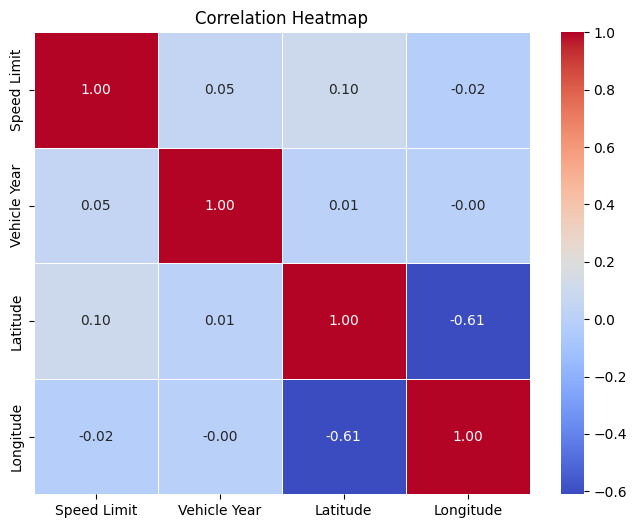

In [ ]:
# Calculate correlation matrix


# Select relevant features
corr_df = df[['Speed Limit', 'Vehicle Year', 'Latitude', 'Longitude']]

# Calculate correlation matrix
corr_matrix = corr_df.corr()

# Create a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

Classification:
    
Classification is a type of supervised machine learning task where the goal is to assign input data to predefined categories or classes. The algorithm’s job in classification is to create a recipe (model) that separates data into different classes. For example, it would learn to distinguish between “Yes” (good wine bottles) and “No” (not-so-yummy wine bottles) based on features like alcohol content or acidity1.

    Problem Statement 1:

    Predicting whether a collision resulted in severe injuries (e.g., “Injury Severity” = “Fatal” or “Serious”) or minor injuries (e.g., “Injury Severity” = “Slight”).

    Problem Statement 2:
    
    Categorizing collisions based on factors like weather conditions (e.g., “Weather” = “Clear,” “Rainy,” “Snowy,” etc.).





Filter Methods:
    
#    Filter-based methods evaluate the relevance of features independently of the chosen model.
    
    Examples include:
    
    Correlation: Assess the correlation between each feature and the target variable.
    
    ANOVA (Analysis of Variance): Evaluate the variance between groups for categorical features.
    
    Chi-squared test: Assess the independence of categorical features and the target variable.

Regression:
  Regression is another type of supervised machine learning task, but it deals with continuous numeric output.

  Regression models aim to find coefficients that best fit the data, allowing you to predict numeric values.
  
    Problem Statement1:
    Predicting the speed of vehicles involved in collisions (e.g., “Speed Limit” or estimated speed).

    Problem Statement2:
    Estimating the severity of vehicle damage (e.g., “Vehicle Damage Extent”).


Prediction:

    Prediction is a broader term that encompasses both classification and regression.
  
    Prediction refers to the overall task of using features (such as location, time, weather, etc.) to make informed predictions about various aspects of traffic collisions.

    Whether you’re predicting injury severity, vehicle movement, or any other outcome, the goal is to create models that generalize well to new examples.


To predict collision injury severity using machine learning. We’ll assume you have a dataset with relevant features (such as weather conditions, vehicle speed, etc.) and the target variable “Injury Severity.”

Below is an example using a Random Forest Classifier. Random Forests are robust and effective for classification tasks

In [ ]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report


# Assuming 'Injury Severity' is the target variable
X = df[['Speed Limit', 'Collision Type', 'Weather']] # Features
y = df['Injury Severity']  # Target variable

In [ ]:
# Assuming X contains categorical columns
categorical_columns = X.select_dtypes(include=['object']).columns

# Apply one-hot encoding
X_encoded = pd.get_dummies(X, columns=categorical_columns, drop_first=True)

# Now X_encoded contains numeric features
print(X_encoded.head())  # Check the transformed features

   Speed Limit  Collision Type_ANGLE MEETS LEFT TURN  \
0           15                                 False   
1           40                                 False   
2           35                                 False   
3           40                                 False   
4           35                                 False   

   Collision Type_ANGLE MEETS RIGHT TURN  Collision Type_HEAD ON  \
0                                  False                   False   
1                                  False                   False   
2                                  False                   False   
3                                  False                   False   
4                                  False                   False   

   Collision Type_HEAD ON LEFT TURN  \
0                             False   
1                             False   
2                             False   
3                             False   
4                              True   

   Collision Type_O

In [ ]:
from sklearn.preprocessing import LabelEncoder

# Initialize the LabelEncoder
label_encoder = LabelEncoder()

# Fit and transform the target variable
y_encoded = label_encoder.fit_transform(y)

# Now y_encoded contains numeric labels
print(y_encoded[:10])  # Check the transformed labels


[1 1 1 1 1 1 1 3 1 1]


In [ ]:
# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_encoded, y_encoded, test_size=0.2, random_state=42)

## Random Forest

It is robust and effective for classification tasks

In [ ]:
# Initialize the Random Forest Classifier
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
# Train the model
rf_classifier.fit(X_train, y_train)
# Make predictions on the test set
y_pred = rf_classifier.predict(X_test)
# Evaluate model performance
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.4f}")
print("Classification Report:\n")
print(classification_report(y_test, y_pred))

Accuracy: 0.8196
Classification Report:

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        21
           1       0.82      1.00      0.90     28230
           2       0.12      0.00      0.00      3474
           3       0.27      0.00      0.01      2422
           4       0.00      0.00      0.00       274

    accuracy                           0.82     34421
   macro avg       0.24      0.20      0.18     34421
weighted avg       0.70      0.82      0.74     34421



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


## XGBoost

It is preferred because it's a powerful algorithm that often achieves high accuracy by combining the predictions of multiple weak learners.

In [ ]:
# Instantiate the XGBoost classifier
model = xgb.XGBClassifier(learning_rate=0.2, max_depth=4, n_estimators=250, use_label_encoder=False, eval_metric='mlogloss', random_state=0)
# Train the model
model.fit(X_train, y_train)
# Make predictions
y_pred = model.predict(X_test)
#  Evaluation metrics
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.4f}")
print("Classification Report:\n")
print(classification_report(y_test, y_pred))

Accuracy: 0.8200
Classification Report:

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        21
           1       0.82      1.00      0.90     28230
           2       0.00      0.00      0.00      3474
           3       0.11      0.00      0.00      2422
           4       0.00      0.00      0.00       274

    accuracy                           0.82     34421
   macro avg       0.19      0.20      0.18     34421
weighted avg       0.68      0.82      0.74     34421



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


## Decision Tree

It learns to make predictions by recursively splitting the dataset based on feature values, ultimately creating a tree-like structure of decision rules.

In [ ]:
# Instantiate the Decision Tree classifier
model = DecisionTreeClassifier()
# Train the model
model.fit(X_train, y_train)
# Make predictions
y_pred = model.predict(X_test)
#  Evaluation metrics
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.4f}")
print("Classification Report:\n")
print(classification_report(y_test, y_pred))

Accuracy: 0.8196
Classification Report:

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        21
           1       0.82      1.00      0.90     28230
           2       0.09      0.00      0.00      3474
           3       0.22      0.00      0.00      2422
           4       0.00      0.00      0.00       274

    accuracy                           0.82     34421
   macro avg       0.23      0.20      0.18     34421
weighted avg       0.70      0.82      0.74     34421



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Utilizing Cross Validation : Grid Search CV

In [ ]:
from sklearn.model_selection import GridSearchCV
param_grid_rf = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10]
}


grid_search_rf = GridSearchCV(RandomForestClassifier(random_state=0), param_grid_rf, cv=5, scoring='roc_auc_ovr')

grid_search_rf.fit(X_train, y_train)
best_params_rf = grid_search_rf.best_params_
best_model_rf = grid_search_rf.best_estimator_
print("Best parameters for RandomForest:", best_params_rf)

param_grid_xgb = {
    'n_estimators': [100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [4, 6, 8]
}

grid_search_xgb = GridSearchCV(XGBClassifier(use_label_encoder=False, eval_metric='mlogloss', random_state=0), param_grid_xgb, cv=5, scoring='roc_auc_ovr')
grid_search_xgb.fit(X_train, y_train)

best_params_xgb = grid_search_xgb.best_params_
best_model_xgb = grid_search_xgb.best_estimator_

print("Best parameters for XGBoost:", best_params_xgb)

Best parameters for RandomForest: {'max_depth': 10, 'min_samples_split': 5, 'n_estimators': 200}
Best parameters for XGBoost: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 100}


In [ ]:
# RF
clf_rf = RandomForestClassifier(n_estimators=200, max_depth=10, min_samples_split=5, random_state=0)
clf_rf.fit(X_train, y_train)
y_pred_val_rf = clf_rf.predict(X_test)
accuracyrf = accuracy_score(y_test, y_pred_val_rf)
print(f"Accuracy rf: {accuracyrf:.4f}\n")
print("Classification Report:\n")
print(classification_report(y_test, y_pred))

# XGBoost
clf_xgb = XGBClassifier(learning_rate=0.1, max_depth=4, n_estimators=100, use_label_encoder=False, eval_metric='mlogloss', random_state=0)
clf_xgb.fit(X_train, y_train)
y_pred_val_xgb = clf_xgb.predict(X_test)
accuracyxgb = accuracy_score(y_test, y_pred_val_xgb)
print(f"\nAccuracy xgb: {accuracyxgb:.4f}\n")
print("Classification Report:\n")
print(classification_report(y_test, y_pred))

# Naive Bayes
clf_naive_bayes = CategoricalNB()
clf_naive_bayes.fit(X_train,y_train)
y_pred_val_nb = clf_naive_bayes.predict(X_test)
accuracynb = accuracy_score(y_test, y_pred_val_nb)
print(f"\nAccuracy nb: {accuracynb:.4f}\n")
print("Classification Report:\n")
print(classification_report(y_test, y_pred))

# Decision Tree
clf_dt = DecisionTreeClassifier()
clf_dt.fit(X_train,y_train)
y_pred_val_dt = clf_dt.predict(X_test)
accuracydt = accuracy_score(y_test, y_pred_val_dt)
print(f"\nAccuracy dt: {accuracydt:.4f}\n")
print("Classification Report:\n")
print(classification_report(y_test, y_pred))

Accuracy rf: 0.8201

Classification Report:

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        21
           1       0.82      1.00      0.90     28230
           2       0.09      0.00      0.00      3474
           3       0.22      0.00      0.00      2422
           4       0.00      0.00      0.00       274

    accuracy                           0.82     34421
   macro avg       0.23      0.20      0.18     34421
weighted avg       0.70      0.82      0.74     34421



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Accuracy xgb: 0.8201

Classification Report:

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        21
           1       0.82      1.00      0.90     28230
           2       0.09      0.00      0.00      3474
           3       0.22      0.00      0.00      2422
           4       0.00      0.00      0.00       274

    accuracy                           0.82     34421
   macro avg       0.23      0.20      0.18     34421
weighted avg       0.70      0.82      0.74     34421



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Accuracy nb: 0.8201

Classification Report:

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        21
           1       0.82      1.00      0.90     28230
           2       0.09      0.00      0.00      3474
           3       0.22      0.00      0.00      2422
           4       0.00      0.00      0.00       274

    accuracy                           0.82     34421
   macro avg       0.23      0.20      0.18     34421
weighted avg       0.70      0.82      0.74     34421



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Accuracy dt: 0.8196

Classification Report:

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        21
           1       0.82      1.00      0.90     28230
           2       0.09      0.00      0.00      3474
           3       0.22      0.00      0.00      2422
           4       0.00      0.00      0.00       274

    accuracy                           0.82     34421
   macro avg       0.23      0.20      0.18     34421
weighted avg       0.70      0.82      0.74     34421



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
